In [1]:
# Importing liabraries
import numpy as np
import pandas as pd
# pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
import matplotlib.pyplot as plt
import seaborn as sns
import os
import datetime
from prophet import Prophet

# Enable inline plotting
%matplotlib inline

In [2]:
aep=pd.read_csv("../data/AEP_hourly.csv")
df = aep.copy()

In [3]:
df.rename(columns={'Datetime': 'ds', 'AEP_MW': 'y'}, inplace=True)
df

,ds,y
0,2004-12-31 01:00:00,13478.0
1,2004-12-31 02:00:00,12865.0
2,2004-12-31 03:00:00,12577.0
3,2004-12-31 04:00:00,12517.0
4,2004-12-31 05:00:00,12670.0
...,...,...
121268,2018-01-01 20:00:00,21089.0
121269,2018-01-01 21:00:00,20999.0
121270,2018-01-01 22:00:00,20820.0
121271,2018-01-01 23:00:00,20415.0


### Select when the data begins

In [56]:
res = df[~(df['ds'] < '2015-01-01')]

### Generate the model

In [82]:
train = df.iloc[:len(df) - 365]
test = df.iloc[len(df) - 365:]

In [83]:
m = Prophet()
m.fit(train)

c:\Users\alvar\anaconda3\envs\asiot\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [31]:
# import joblib 
# joblib.dump(m, 'prophet_model_cut.pkl') # Guardo el modelo.

['prophet_model_cut.pkl']

### Predictions

In [32]:
# import joblib 
# m = joblib.load("prophet_model_cut.pkl")

In [84]:
# future = m.make_future_dataframe(periods=365, freq="H") #MS for monthly, H for hourly
future = m.make_future_dataframe(periods=365) #MS for monthly, H for hourly
forecast = m.predict(future)

c:\Users\alvar\anaconda3\envs\asiot\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

c:\Users\alvar\anaconda3\envs\asiot\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [61]:
mascara = (forecast["ds"] >= '2018-03-01') & (forecast["ds"] <= '2018-03-20')

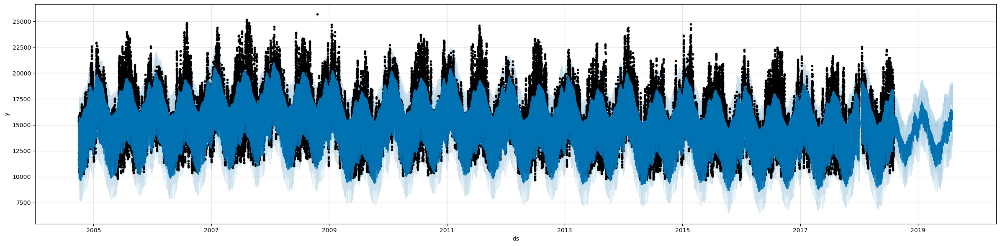

In [85]:
fig = m.plot(forecast, figsize=(24,6))

In [8]:
from prophet.plot import plot_components_plotly

In [86]:
plot_components_plotly(m,forecast)

c:\Users\alvar\anaconda3\envs\asiot\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

c:\Users\alvar\anaconda3\envs\asiot\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

c:\Users\alvar\anaconda3\envs\asiot\lib\site-packages\prophet\forecaster.py:896: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



# Model evaluation

- **yhat**: forecast
- **yhat_lower, yhat_upper**: uncertainty interval

In [49]:
from statsmodels.tools.eval_measures import rmse


In [87]:
predictions = forecast.iloc[-365:]['yhat']

In [90]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))
print("Mean Value of Test Dataset:", test['y'].mean())

Root Mean Squared Error between actual and  predicted values:  5221.58456733386
Mean Value of Test Dataset: 18655.30410958904


In [91]:
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2004-10-01 01:00:00,15312.975373,10813.672508,14746.620902,15312.975373,15312.975373,-2508.798803,-2508.798803,-2508.798803,-1520.251998,...,485.166423,485.166423,485.166423,-1473.713228,-1473.713228,-1473.713228,0.0,0.0,0.0,12804.176569
1,2004-10-01 02:00:00,15313.062548,10247.761973,14201.754523,15313.062548,15313.062548,-3094.480649,-3094.480649,-3094.480649,-2094.043619,...,474.853252,474.853252,474.853252,-1475.290282,-1475.290282,-1475.290282,0.0,0.0,0.0,12218.581899
2,2004-10-01 03:00:00,15313.149723,9926.245163,13874.549740,15313.149723,15313.149723,-3435.507423,-3435.507423,-3435.507423,-2422.263061,...,463.623694,463.623694,463.623694,-1476.868056,-1476.868056,-1476.868056,0.0,0.0,0.0,11877.642300
3,2004-10-01 04:00:00,15313.236898,9698.494401,13843.536335,15313.236898,15313.236898,-3484.197257,-3484.197257,-3484.197257,-2457.120764,...,451.370028,451.370028,451.370028,-1478.446521,-1478.446521,-1478.446521,0.0,0.0,0.0,11829.039641
4,2004-10-01 05:00:00,15313.324073,10220.296197,14196.752721,15313.324073,15313.324073,-3208.385702,-3208.385702,-3208.385702,-2166.337713,...,437.977660,437.977660,437.977660,-1480.025650,-1480.025650,-1480.025650,0.0,0.0,0.0,12104.938371
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121264,2019-07-30 00:00:00,15158.709994,13991.320841,19185.555487,13561.156763,16937.693804,1306.488844,1306.488844,1306.488844,-760.888621,...,654.789501,654.789501,654.789501,1412.587964,1412.587964,1412.587964,0.0,0.0,0.0,16465.198838
121265,2019-07-31 00:00:00,15159.298228,13707.344664,19091.139137,13557.042649,16951.952408,1100.297297,1100.297297,1100.297297,-760.888621,...,477.481122,477.481122,477.481122,1383.704796,1383.704796,1383.704796,0.0,0.0,0.0,16259.595525
121266,2019-08-01 00:00:00,15159.886461,13785.292332,18803.580050,13553.007521,16966.211012,1163.174368,1163.174368,1163.174368,-760.888621,...,571.942061,571.942061,571.942061,1352.120928,1352.120928,1352.120928,0.0,0.0,0.0,16323.060829
121267,2019-08-02 00:00:00,15160.474695,13759.673287,19018.576921,13548.972394,16980.469616,1052.547557,1052.547557,1052.547557,-760.888621,...,494.662850,494.662850,494.662850,1318.773328,1318.773328,1318.773328,0.0,0.0,0.0,16213.022252
